<a href="https://colab.research.google.com/github/tarboledah/SyS/blob/main/Parcial3/Parcial3_punto2.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Pregunta 2

Sea la señal portadora $c(t) = A_c\sin(2\pi F_c t),$ con $A_c,F_c\in\mathbb{R},$ y la señal mensaje $m(t)\in\mathbb{R}$. Encuentre el espectro en frecuencia de la señal modulada en amplitud (AM), $y(t) = \left(1+\frac{m(t)}{A_c}\right)c(t)$. Luego, descargue desde youtube $5$ segundos de su canción favorita. Presente una simulación de modulación por amplitud AM (tomando como mensaje el fragmento de la canción escogida). Grafique las señales en tiempo y frecuencia (magnitud y fase) de la señal mensaje, portadora y modulada. Posteriormente, a partir del esquema
de la siguiente figura:
![Circuito RLC](https://github.com/amalvarezme/SenalesSistemas/blob/master/Otros/AM.jpeg?raw=1)
\
y asumiendo $\theta = 0$, presente una simulacion sobre Python para el proceso de demodulacion en amplitud. Especifique adecuadamente las consideraciones de diseno en tiempo y en frecuencia (con las graficas pertinentes), y reproduzca el segmento de la cancion para cada una de las etapas del sistema de modulacion y demodulacion. Tenga en cuenta el diseno de un filtro digital pasa bajas en la etapa de demodulacion, utilizando Transformada Z. Presente la grafica de polos y ceros y el diagrama de Bode del filtro (se sugiere tener en cuenta el cuaderno Transformada Z).
\
Finalmente, la simulacion tipo dashboard debera tambien permitir la reproduccion de los fragmentos de audio del mensaje, portadora y senal modulada, y detectar el tipo de genero musical del audio empleado. Para ello se deben escoger al menos dos generos musicales en la etapa de entrenamiento del sistema. Nota: se sugiere utilizar un canal de senal de audio para el desarrollo del ejercicio. El usuario debe poder escoger el ındice de modulacion deseado


## Solución:

La transformada de Fourier de la señal modulada se puede encontrar como:

$$Y(\omega) = \mathcal{F}\{y(t)\} = \mathcal{F}\left\{\left(1+\frac{m(t)}{A_c}\right)c(t)\right\}=\mathcal{F}\{c(t)\}+\frac{1}{A_c}\mathcal{F}\{m(t)c(t)\}$$

En este caso (utilizando tablas de Fourier):

$$C(\omega) = \mathcal{F}\{c(t)\} = \mathcal{F}\{A_c\sin(2\pi F_c t)\} = A_c\mathcal{F}\left\{\frac{e^{2\pi F_ct}-e^{-2\pi F_ct}}{2j}\right\}$$

y

$$\mathcal{F\{e^{\pm j\omega_0 t}\}} = 2\pi\delta(\omega \mp \omega_0)$$

Por consiguiente:

$$\boxed{C(\omega) = \frac{A_c\pi}{j}(\delta(\omega - 2\pi F_c)-\delta(\omega + 2\pi F_c))}$$

De forma similar:

$$\frac{1}{A_c}\mathcal{F}\{m(t)c(t)\} = \frac{1}{A_c}\mathcal{F}\{m(t)A_c\sin(2\pi F_c t)\} = \mathcal{F}\{m(t)\sin(2\pi F_c t)\} = \mathcal{F}\left\{\frac{m(t)e^{2\pi F_ct}-m(t)e^{-2\pi F_ct}}{2j}\right\}$$

teniendo en cuenta que:

$$\mathcal{F}\{x(t)e^{\pm j\omega_0t}\} = X(\omega \mp \omega_0)$$


Entonces:

$$\boxed{\frac{1}{A_c}\mathcal{F}\{m(t)c(t)\} = \frac{1}{2j}\left(M(\omega - 2\pi F_c)-M(\omega + 2\pi F_c)\right)}$$


Finalmente, el espectro de la señal modulada se puede escribir como:

$$\boxed{Y(\omega) = \frac{A_c\pi}{j}(\delta(\omega - 2\pi F_c)-\delta(\omega + 2\pi F_c)) + \frac{1}{2j}\left(M(\omega - 2\pi F_c)-M(\omega + 2\pi F_c)\right)}$$

In [ ]:
# Descargar mp3 videos youtube
!python3 -m pip install --force-reinstall https://github.com/yt-dlp/yt-dlp/archive/master.tar.gz

import os
import yt_dlp as youtube_dl
def download_ytvid_as_mp3(video_url,name):
    #video_url = input("enter url of youtube video:")
    video_info = youtube_dl.YoutubeDL().extract_info(url = video_url,download=False)
    filename = f"{name}.mp3"
    options={
        'format':'bestaudio/best',
        'keepvideo':False,
        'outtmpl':filename,
    }

    with youtube_dl.YoutubeDL(options) as ydl:
        ydl.download([video_info['webpage_url']])

    print("Download complete... {}".format(filename))

# Lista links videos y nombres salida mp3
link_= ["https://www.youtube.com/watch?v=v71WJ1qOxwA" ]
name_ = ['Mi estilo de vida']
for name,link in zip(name_,link_):
    print(name)
    download_ytvid_as_mp3(link,name)

#Convertir mp3 a wav
import subprocess

for name in name_:
    subprocess.call(['ffmpeg','-y', '-i', name+'.mp3',
                   name+'.wav'])

#Leer wav en numpy
!pip install soundfile

import soundfile as sf # para instalar pip install soundfile
#lee archivos wav
for name in name_:
    nombre_out = "output.wav"
    x, fs = sf.read(name+'.wav')

    print('Frecuencia de muestreo %.2f[Hz]\naudio %s' % (fs,name+'.wav'))

#Reproducir audio
from IPython.display import Audio
ns = 60 #se reproducen los primeros ns segundos
Audio(x[:int(fs*ns),:].T,rate=fs)

     - 2.7 MB 9.8 MB/s 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached certifi-2024.8.30-py3-none-any.whl.metadata (2.2 kB)
  Using cached requests-2.32.3-py3-none-any.whl.metadata (4.6 kB)
  Using cached urllib3-2.2.3-py3-none-any.whl.metadata (6.5 kB)
  Using cached charset_normalizer-3.3.2-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (33 kB)
  Using cached idna-3.10-py3-none-any.whl.metadata (10 kB)
Using cached requests-2.32.3-py3-none-any.whl (64 kB)
Using cached certifi-2024.8.30-py3-none-any.whl (167 kB)
Using cached urllib3-2.2.3-py3-none-any.whl (126 kB)
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 164.1/164.1 kB 3.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 3.0/3.0 MB 37.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 194.4/194.4 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 2.3/2.3 MB 42.3

In [ ]:
from IPython.display import Audio #librería para reproducir audio
#leer archivo wav
for name in name_:
    nombre_out = "output.wav"
    x, fs = sf.read(name+'.wav')

    print('Frecuencia de muestreo %.2f[Hz]\naudio %s' % (fs,name+'.wav'))

xpro = x.copy() #copiar archivos para procesar
#leer 5 segundos de la canción
ti = 47 #tiempo incio a procesar seg
tf = 57 #tiempo final a procesar seg
m = xpro[int(ti*fs):int((tf*fs)),0] #señal mensaje en primer canal

#repoducir fragmento original #señal mensaje
Audio(m,rate=fs)

Frecuencia de muestreo 44100.00[Hz]
audio Mi estilo de vida.wav


#**Simulación de modulación por amplitud AM**

Se fija una $F_c >> F_{max},$ para nuestro caso:

$$\boxed{F_c = 15000 [Hz]}$$

Además, teniendo en cuenta que el índice de modulación se define como:

$$ I_m = \frac{\max(|m(t)|)}{A_c}$$

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
tt = np.arange(ti,tf,1/fs)
Fc = 15000 #frecuencia portadora
#Im = 0.5 # Im = peak(m(t))/Ac ->  Ac = peak(m(t))/Im
Im = float(input("Ingrese el índice de modulación deseado (Im): "))
Ac = max(abs(m))/Im #amplitud de la portadora según índice de modulación
c = Ac*np.sin(2*np.pi*Fc*tt) #portadora

Ingrese el índice de modulación deseado (Im): 1


In [ ]:
#señal modulada
A1 = 2
y = A1*m*c #señal modulada en AM

In [ ]:
#repoducir modulada
Audio(y,rate=fs)

#**Graficas para la señal mensaje**

In [ ]:
#repoducir fragmento original #señal mensaje
Audio(m,rate=fs)

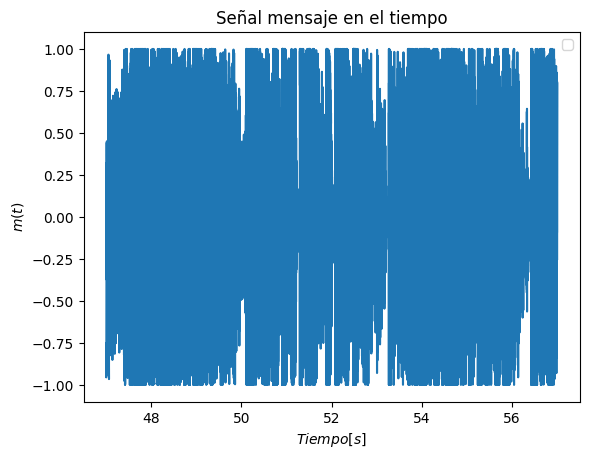

In [ ]:
#Señal mensaje en tiempo y frecuencia
tt = np.arange(ti,tf,1/fs) # vector de tiempo
plt.plot(tt,m) #graficar señal mensaje en el tiempo
plt.title(r'Señal mensaje en el tiempo')
plt.xlabel('$Tiempo [s]$')
plt.ylabel('$m(t)$')
plt.legend()
plt.show()

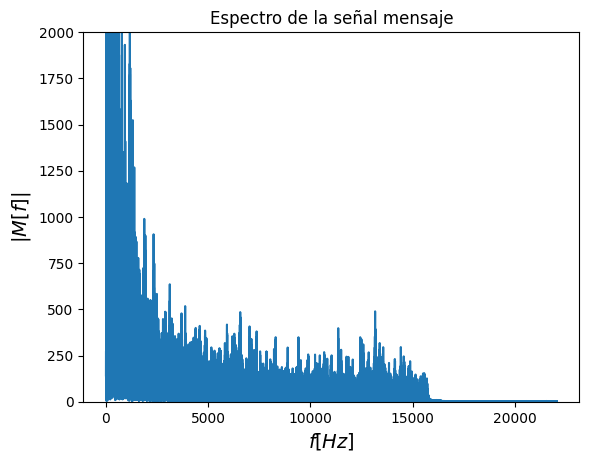

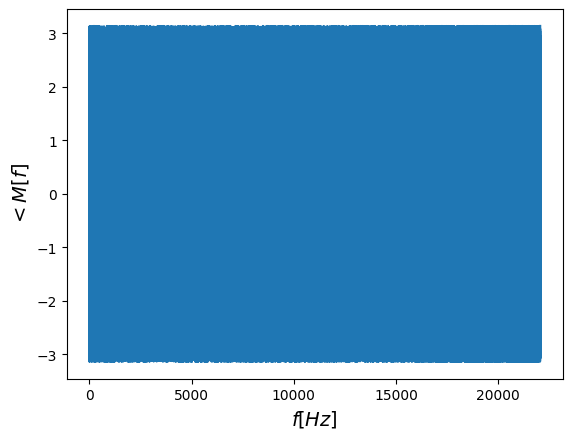

In [ ]:
#Fourier señal mensaje
Mw = np.fft.rfft(m) # axis=0 permite aplicar fft por cada columna de xpro
vf = np.fft.rfftfreq(m.shape[0],1/fs) #se crea el vector de frecuencias
plt.plot(vf,abs(Mw))#se grafica la magnitud
plt.title(r'Espectro de la señal mensaje')
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$|M[f]|$',fontsize = 14)
plt.ylim(0, 2000)
plt.show()

plt.plot(vf, np.angle(Mw))#fase del espectro
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$<M[f]$',fontsize = 14)
plt.show()


#**Graficas para la señal Portadora**

In [ ]:
#repoducir fragmento #señal portadora
c = Ac*np.sin(2*np.pi*Fc*tt) #portadora
Audio(c,rate=fs)

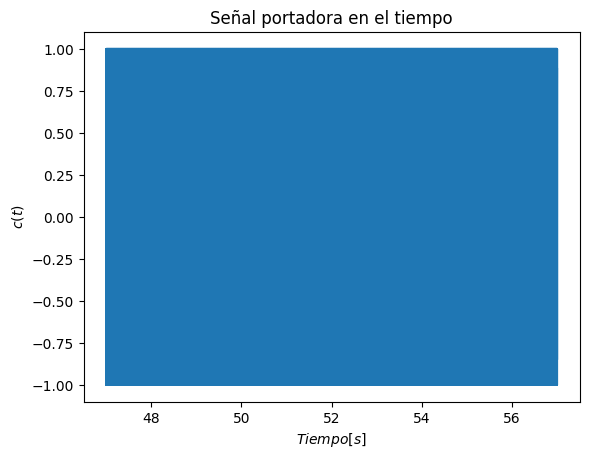

In [ ]:
#Señal portadora en tiempo y frecuencia
plt.plot(tt,c) #graficar señal mensaje en el tiempo
plt.title(r'Señal portadora en el tiempo')
plt.xlabel('$Tiempo [s]$')
plt.ylabel('$c(t)$')
plt.show()

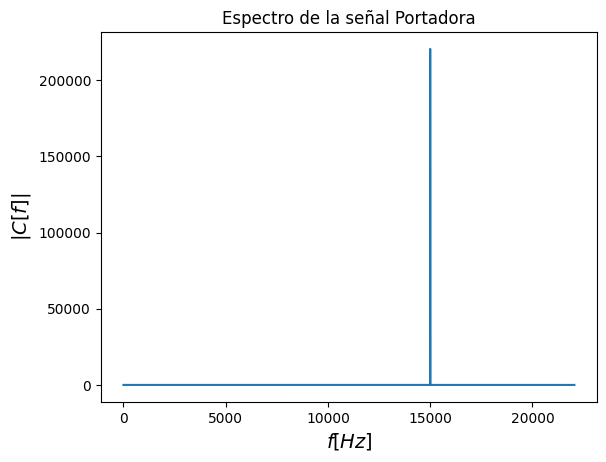

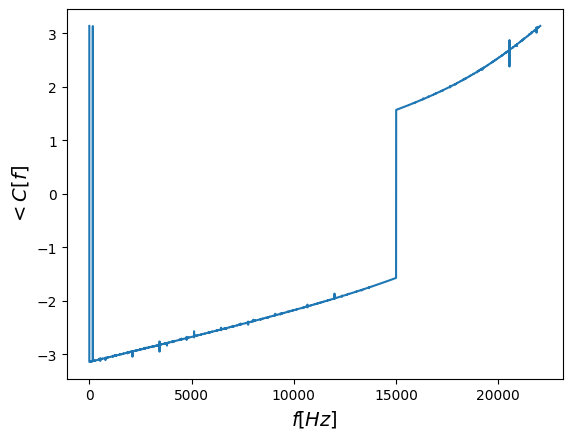

In [ ]:
#Fourier señal portadora
Cw = np.fft.rfft(c) # axis=0 permite aplicar fft por cada columna de xpro
plt.plot(vf,abs(Cw))#se grafica la magnitud
plt.title(r'Espectro de la señal Portadora')
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$|C[f]|$',fontsize = 14)
plt.show()


plt.plot(vf, np.angle(Cw))#fase del espectro
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$<C[f]$',fontsize = 14)
plt.show()

#**Graficas para la señal modulada**

In [ ]:
#repoducir modulada
Audio(y,rate=fs)

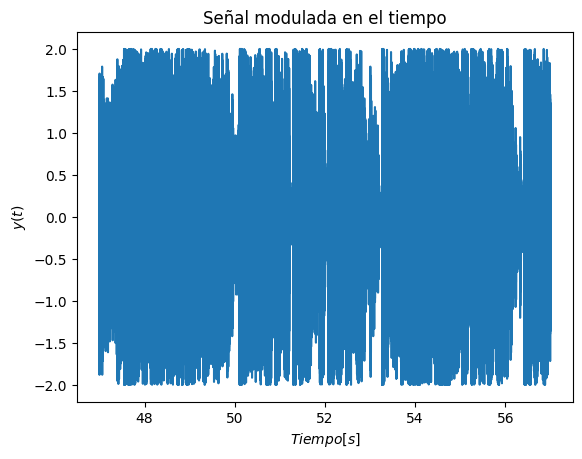

In [ ]:
plt.plot(tt,y) #graficar señal modulada en el tiempo
plt.title(r'Señal modulada en el tiempo')
plt.xlabel('$Tiempo [s]$')
plt.ylabel('$y(t)$')
plt.show()

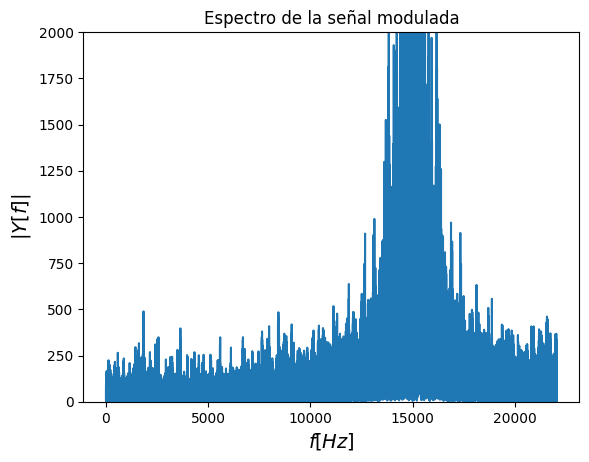

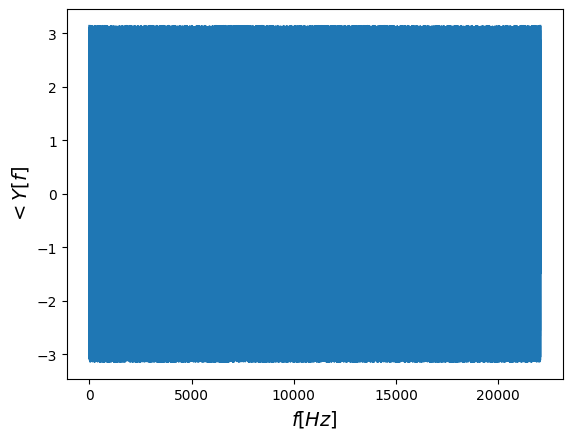

In [ ]:
#Fourier señal modulada
Yw = np.fft.rfft(y) # axis=0 permite aplicar fft por cada columna de xpro
plt.plot(vf,abs(Yw))#se grafica la magnitud
plt.title(r'Espectro de la señal modulada')
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$|Y[f]|$',fontsize = 14)
plt.ylim(0, 2000)
plt.show()


plt.plot(vf, np.angle(Yw))#fase del espectro
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$<Y[f]$',fontsize = 14)
plt.show()

#**Simulacion de demodulacion en amplitud**

In [ ]:
d = y*c #señal demodulada

#repoducir señal demodulada
Audio(d,rate=fs)

#**Graficas para la señal demodulada**

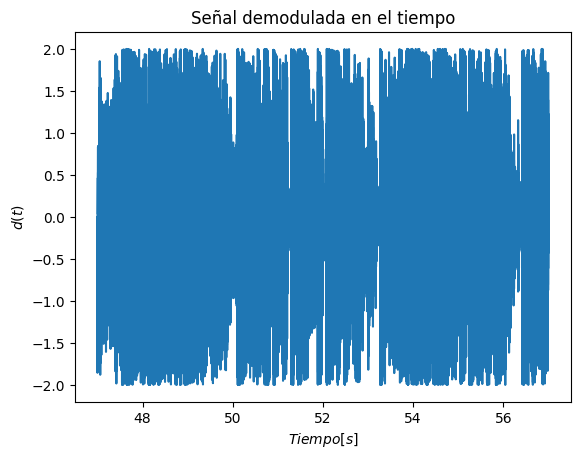

In [ ]:
#graficar señal demodulada en tiempo
plt.plot(tt,d)
plt.title(r'Señal demodulada en el tiempo')
plt.xlabel('$Tiempo [s]$')
plt.ylabel('$d(t)$')
plt.show()

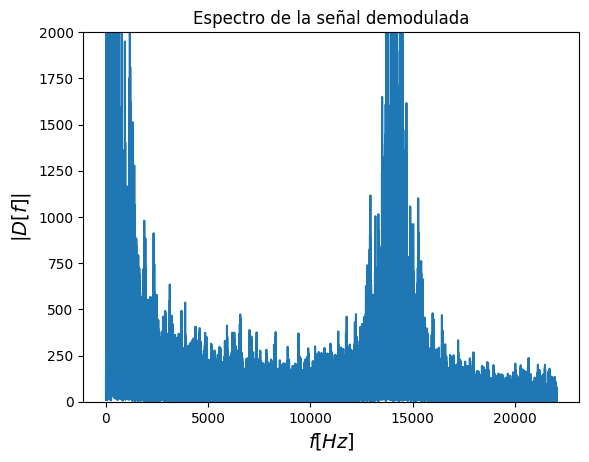

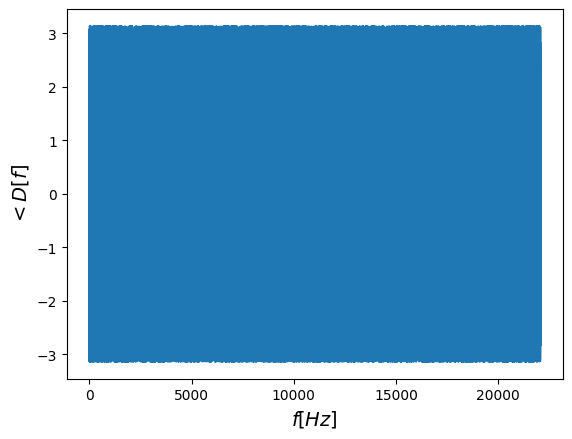

In [ ]:
#Fourier señal demodulada
Dw = np.fft.rfft(d) # axis=0 permite aplicar fft por cada columna de xpro
plt.plot(vf,abs(Dw))#se grafica la magnitud
plt.title(r'Espectro de la señal demodulada')
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$|D[f]|$',fontsize = 14)
plt.ylim(0, 2000)
plt.show()


plt.plot(vf, np.angle(Dw))#fase del espectro
plt.xlabel(r'$f[Hz]$',fontsize = 14)
plt.ylabel(r'$<D[f]$',fontsize = 14)
plt.show()

#**Segmento de la cancion para cada una de las etapas del sistema: Modulacion y Demodulacion**

In [ ]:
#repoducir modulada
Audio(y,rate=fs)

In [ ]:
#repoducir señal demodulada
Audio(d,rate=fs)